## Credit Default Prediction with Machine Learning

In [1]:
#import dependencies
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
print ('ready')

ready


### Loading Datasets with Pandas

In [2]:
df_train=pd.read_csv('credit_train.csv')
df_test=pd.read_csv('credit_test.csv')

### Explorative Data Analysis

In [3]:
df_train.shape

(100514, 19)

In [4]:
df_test.shape

(10353, 18)

In [5]:
df_test.columns

Index(['Loan ID', 'Customer ID', 'Current Loan Amount', 'Term', 'Credit Score',
       'Annual Income', 'Years in current job', 'Home Ownership', 'Purpose',
       'Monthly Debt', 'Years of Credit History',
       'Months since last delinquent', 'Number of Open Accounts',
       'Number of Credit Problems', 'Current Credit Balance',
       'Maximum Open Credit', 'Bankruptcies', 'Tax Liens'],
      dtype='object')

In [6]:
df_train.columns

Index(['Loan ID', 'Customer ID', 'Loan Status', 'Current Loan Amount', 'Term',
       'Credit Score', 'Annual Income', 'Years in current job',
       'Home Ownership', 'Purpose', 'Monthly Debt', 'Years of Credit History',
       'Months since last delinquent', 'Number of Open Accounts',
       'Number of Credit Problems', 'Current Credit Balance',
       'Maximum Open Credit', 'Bankruptcies', 'Tax Liens'],
      dtype='object')

In [7]:
df_train.describe()

,Current Loan Amount,Credit Score,Annual Income,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
count,1.000000e+05,80846.000000,8.084600e+04,100000.000000,100000.000000,46859.000000,100000.00000,100000.000000,1.000000e+05,9.999800e+04,99796.000000,99990.000000
mean,1.176045e+07,1076.456089,1.378277e+06,18472.412336,18.199141,34.901321,11.12853,0.168310,2.946374e+05,7.607984e+05,0.117740,0.029313
std,3.178394e+07,1475.403791,1.081360e+06,12174.992609,7.015324,21.997829,5.00987,0.482705,3.761709e+05,8.384503e+06,0.351424,0.258182
min,1.080200e+04,585.000000,7.662700e+04,0.000000,3.600000,0.000000,0.00000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,1.796520e+05,705.000000,8.488440e+05,10214.162500,13.500000,16.000000,8.00000,0.000000,1.126700e+05,2.734380e+05,0.000000,0.000000
50%,3.122460e+05,724.000000,1.174162e+06,16220.300000,16.900000,32.000000,10.00000,0.000000,2.098170e+05,4.678740e+05,0.000000,0.000000
75%,5.249420e+05,741.000000,1.650663e+06,24012.057500,21.700000,51.000000,14.00000,0.000000,3.679588e+05,7.829580e+05,0.000000,0.000000
max,1.000000e+08,7510.000000,1.655574e+08,435843.280000,70.500000,176.000000,76.00000,15.000000,3.287897e+07,1.539738e+09,7.000000,15.000000


In [8]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100514 entries, 0 to 100513
Data columns (total 19 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   Loan ID                       100000 non-null  object 
 1   Customer ID                   100000 non-null  object 
 2   Loan Status                   100000 non-null  object 
 3   Current Loan Amount           100000 non-null  float64
 4   Term                          100000 non-null  object 
 5   Credit Score                  80846 non-null   float64
 6   Annual Income                 80846 non-null   float64
 7   Years in current job          95778 non-null   object 
 8   Home Ownership                100000 non-null  object 
 9   Purpose                       100000 non-null  object 
 10  Monthly Debt                  100000 non-null  float64
 11  Years of Credit History       100000 non-null  float64
 12  Months since last delinquent  46859 non-null

In [9]:
df_train.isnull().sum()

Loan ID                           514
Customer ID                       514
Loan Status                       514
Current Loan Amount               514
Term                              514
Credit Score                    19668
Annual Income                   19668
Years in current job             4736
Home Ownership                    514
Purpose                           514
Monthly Debt                      514
Years of Credit History           514
Months since last delinquent    53655
Number of Open Accounts           514
Number of Credit Problems         514
Current Credit Balance            514
Maximum Open Credit               516
Bankruptcies                      718
Tax Liens                         524
dtype: int64

In [10]:
df_test.describe()

,Current Loan Amount,Credit Score,Annual Income,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
count,1.000000e+04,8019.000000,8.019000e+03,10000.000000,10000.000000,4694.000000,10000.00000,10000.000000,1.000000e+04,1.000000e+04,9978.000000,9999.000000
mean,1.160380e+07,1077.991520,1.369106e+06,18429.671699,18.235930,34.964636,11.08410,0.165500,2.907301e+05,6.871308e+05,0.116356,0.030803
std,3.160010e+07,1477.467761,8.687557e+05,12399.956192,7.018356,21.640291,5.02338,0.500934,3.881687e+05,1.861394e+06,0.349961,0.288215
min,1.947000e+04,585.000000,8.109200e+04,0.000000,3.800000,0.000000,1.00000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,1.789480e+05,706.000000,8.483405e+05,10202.857500,13.600000,17.000000,7.00000,0.000000,1.086515e+05,2.706000e+05,0.000000,0.000000
50%,3.092760e+05,725.000000,1.168272e+06,16052.055000,17.000000,32.000000,10.00000,0.000000,2.075180e+05,4.626050e+05,0.000000,0.000000
75%,5.157075e+05,741.000000,1.664390e+06,23881.337500,21.700000,50.000000,14.00000,0.000000,3.624630e+05,7.861150e+05,0.000000,0.000000
max,1.000000e+08,7510.000000,1.781535e+07,229057.920000,62.500000,131.000000,55.00000,10.000000,1.623744e+07,1.459073e+08,5.000000,9.000000


In [11]:
df_test.isnull().sum()

Loan ID                          353
Customer ID                      353
Current Loan Amount              353
Term                             353
Credit Score                    2334
Annual Income                   2334
Years in current job             780
Home Ownership                   353
Purpose                          353
Monthly Debt                     353
Years of Credit History          353
Months since last delinquent    5659
Number of Open Accounts          353
Number of Credit Problems        353
Current Credit Balance           353
Maximum Open Credit              353
Bankruptcies                     375
Tax Liens                        354
dtype: int64

In [12]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10353 entries, 0 to 10352
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Loan ID                       10000 non-null  object 
 1   Customer ID                   10000 non-null  object 
 2   Current Loan Amount           10000 non-null  float64
 3   Term                          10000 non-null  object 
 4   Credit Score                  8019 non-null   float64
 5   Annual Income                 8019 non-null   float64
 6   Years in current job          9573 non-null   object 
 7   Home Ownership                10000 non-null  object 
 8   Purpose                       10000 non-null  object 
 9   Monthly Debt                  10000 non-null  float64
 10  Years of Credit History       10000 non-null  float64
 11  Months since last delinquent  4694 non-null   float64
 12  Number of Open Accounts       10000 non-null  float64
 13  N

In [13]:
from pandas_profiling import ProfileReport
# Generate a profile report
profile_train = ProfileReport(df_train, title='Credit_train_Pandas Profiling Report', explorative=True)
profile_test = ProfileReport(df_test, title='Credit_test_Pandas Profiling Report', explorative=True)
# Save the report to an HTML file
profile_train.to_file("pandas_profiling_report.html")
profile_test.to_file("pandas_profiling_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

C:\Users\LENOVO\anaconda3\lib\site-packages\scipy\stats\stats.py:4812: RuntimeWarning: overflow encountered in longlong_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [14]:
profile_test

In [15]:
profile_train

In [16]:
### Checking for Missing data (Nans) in the datafarme using the library missingno
import missingno as msno
msno.bar(df_train)
%matplotlib inline
# Null values found in the 2 pressure columns

<AxesSubplot:>

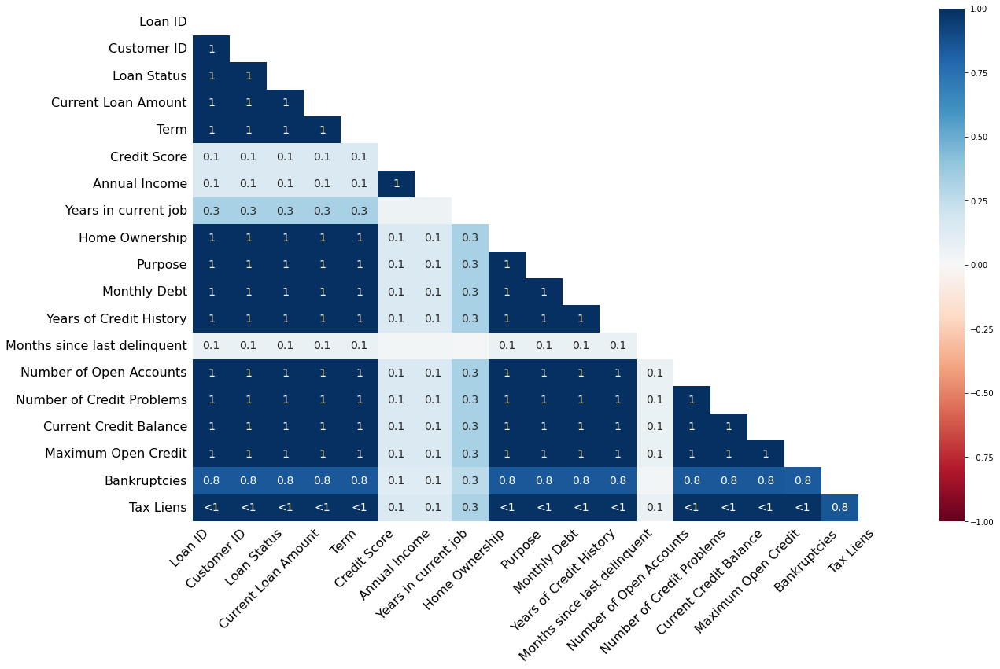

In [17]:
msno.heatmap(df_train)

<AxesSubplot:>

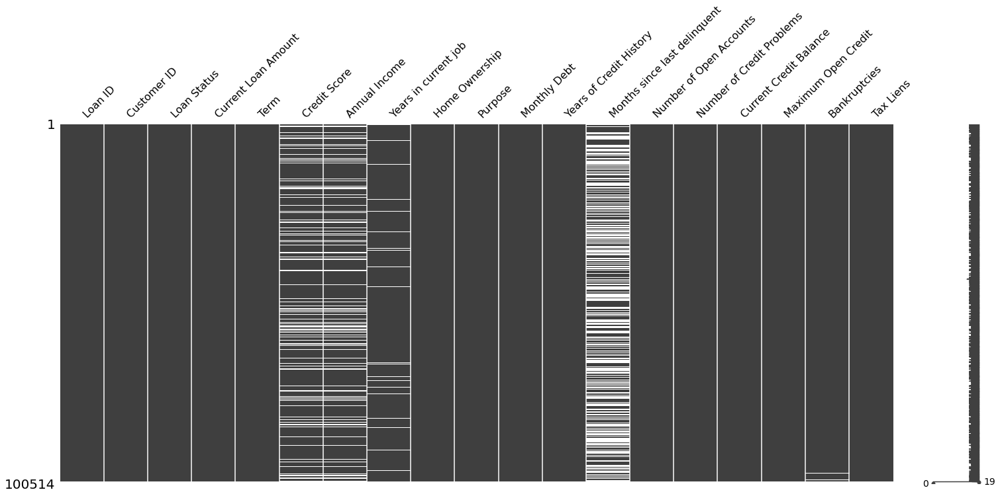

In [18]:
msno.matrix(df_train)

In [19]:
### Checking for Missing data (Nans) in the datafarme using the library missingno
import missingno as msno
msno.bar(df_test)
%matplotlib inline
# Null values found in the 2 pressure columns

<AxesSubplot:>

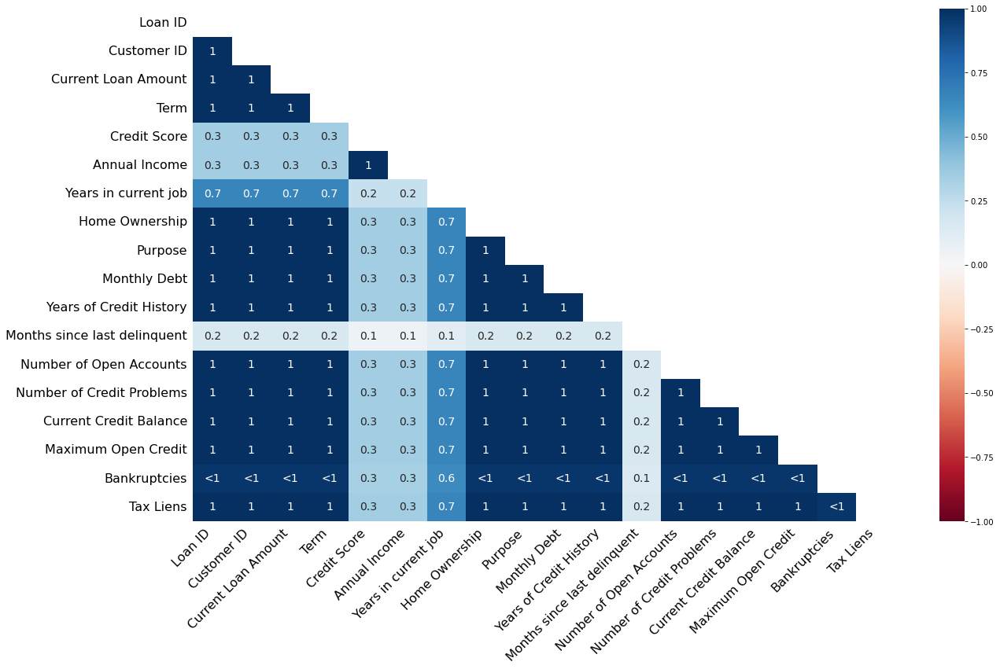

In [20]:
msno.heatmap(df_test)

<AxesSubplot:>

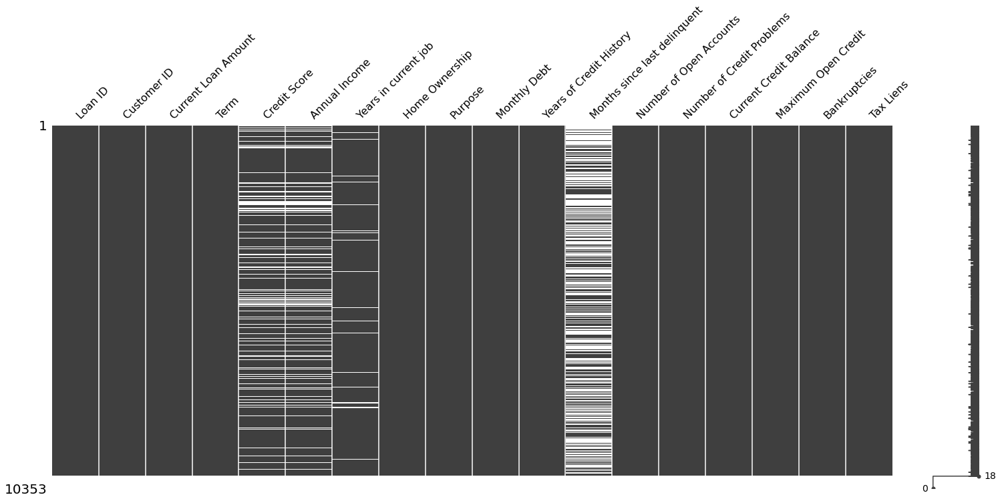

In [21]:
msno.matrix(df_test)

In [22]:
df_train = df_train.dropna()

In [23]:
df_test=df_test.dropna()

In [24]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 36423 entries, 2 to 99997
Data columns (total 19 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Loan ID                       36423 non-null  object 
 1   Customer ID                   36423 non-null  object 
 2   Loan Status                   36423 non-null  object 
 3   Current Loan Amount           36423 non-null  float64
 4   Term                          36423 non-null  object 
 5   Credit Score                  36423 non-null  float64
 6   Annual Income                 36423 non-null  float64
 7   Years in current job          36423 non-null  object 
 8   Home Ownership                36423 non-null  object 
 9   Purpose                       36423 non-null  object 
 10  Monthly Debt                  36423 non-null  float64
 11  Years of Credit History       36423 non-null  float64
 12  Months since last delinquent  36423 non-null  float64
 13  N

In [25]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3573 entries, 2 to 9998
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Loan ID                       3573 non-null   object 
 1   Customer ID                   3573 non-null   object 
 2   Current Loan Amount           3573 non-null   float64
 3   Term                          3573 non-null   object 
 4   Credit Score                  3573 non-null   float64
 5   Annual Income                 3573 non-null   float64
 6   Years in current job          3573 non-null   object 
 7   Home Ownership                3573 non-null   object 
 8   Purpose                       3573 non-null   object 
 9   Monthly Debt                  3573 non-null   float64
 10  Years of Credit History       3573 non-null   float64
 11  Months since last delinquent  3573 non-null   float64
 12  Number of Open Accounts       3573 non-null   float64
 13  Num

In [26]:
df_train.isnull().sum()

Loan ID                         0
Customer ID                     0
Loan Status                     0
Current Loan Amount             0
Term                            0
Credit Score                    0
Annual Income                   0
Years in current job            0
Home Ownership                  0
Purpose                         0
Monthly Debt                    0
Years of Credit History         0
Months since last delinquent    0
Number of Open Accounts         0
Number of Credit Problems       0
Current Credit Balance          0
Maximum Open Credit             0
Bankruptcies                    0
Tax Liens                       0
dtype: int64

In [27]:
df_test.isnull().sum()

Loan ID                         0
Customer ID                     0
Current Loan Amount             0
Term                            0
Credit Score                    0
Annual Income                   0
Years in current job            0
Home Ownership                  0
Purpose                         0
Monthly Debt                    0
Years of Credit History         0
Months since last delinquent    0
Number of Open Accounts         0
Number of Credit Problems       0
Current Credit Balance          0
Maximum Open Credit             0
Bankruptcies                    0
Tax Liens                       0
dtype: int64

In [28]:
df_train.shape

(36423, 19)

### Data Preparation

In [29]:
df_train.drop_duplicates(inplace=True)

C:\Users\LENOVO\anaconda3\lib\site-packages\pandas\util\_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [30]:
df_test.drop_duplicates(inplace=True)

In [31]:
df_train.shape

(31254, 19)

In [32]:
df_train.columns

Index(['Loan ID', 'Customer ID', 'Loan Status', 'Current Loan Amount', 'Term',
       'Credit Score', 'Annual Income', 'Years in current job',
       'Home Ownership', 'Purpose', 'Monthly Debt', 'Years of Credit History',
       'Months since last delinquent', 'Number of Open Accounts',
       'Number of Credit Problems', 'Current Credit Balance',
       'Maximum Open Credit', 'Bankruptcies', 'Tax Liens'],
      dtype='object')

In [33]:
df_test.columns

Index(['Loan ID', 'Customer ID', 'Current Loan Amount', 'Term', 'Credit Score',
       'Annual Income', 'Years in current job', 'Home Ownership', 'Purpose',
       'Monthly Debt', 'Years of Credit History',
       'Months since last delinquent', 'Number of Open Accounts',
       'Number of Credit Problems', 'Current Credit Balance',
       'Maximum Open Credit', 'Bankruptcies', 'Tax Liens'],
      dtype='object')

In [34]:
###Check for Correllation

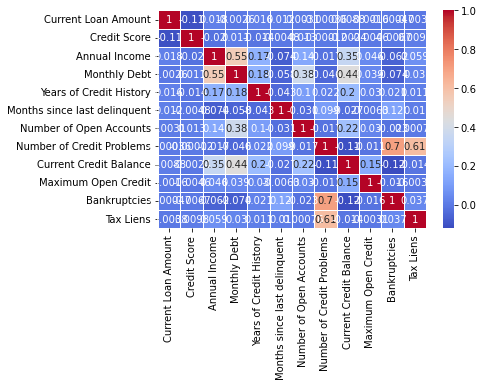

In [35]:
correlation_matrix = df_train.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.show()

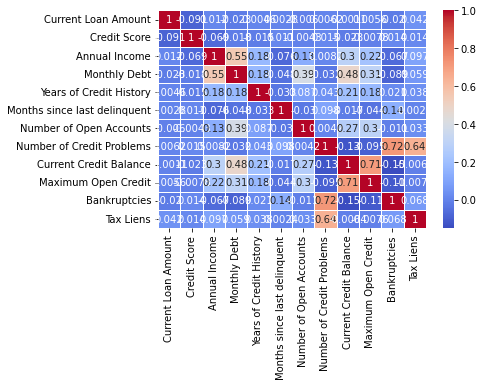

In [36]:
correlation_matrix = df_test.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.show()

In [37]:
drop_columns=['Loan ID','Customer ID',]

In [38]:
df_test=df_test.drop(columns=drop_columns)

In [39]:
df_train=df_train.drop(columns=drop_columns)

In [40]:
df_train.columns

Index(['Loan Status', 'Current Loan Amount', 'Term', 'Credit Score',
       'Annual Income', 'Years in current job', 'Home Ownership', 'Purpose',
       'Monthly Debt', 'Years of Credit History',
       'Months since last delinquent', 'Number of Open Accounts',
       'Number of Credit Problems', 'Current Credit Balance',
       'Maximum Open Credit', 'Bankruptcies', 'Tax Liens'],
      dtype='object')

<AxesSubplot:xlabel='Loan Status', ylabel='count'>

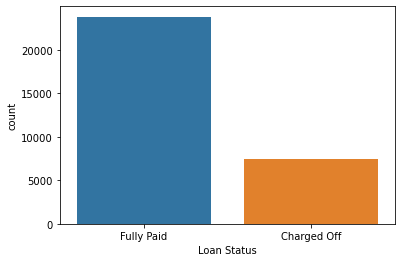

In [41]:
sns.countplot(x='Loan Status',data=df_train)# To be treated as imbalance data set

In [42]:
df_train.head(10)

,Loan Status,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
2,Fully Paid,99999999.0,Short Term,741.0,2231892.0,8 years,Own Home,Debt Consolidation,29200.53,14.9,29.0,18.0,1.0,297996.0,750090.0,0.0,0.0
6,Fully Paid,217646.0,Short Term,730.0,1184194.0,< 1 year,Home Mortgage,Debt Consolidation,10855.08,19.6,10.0,13.0,1.0,122170.0,272052.0,1.0,0.0
8,Fully Paid,548746.0,Short Term,678.0,2559110.0,2 years,Rent,Debt Consolidation,18660.28,22.6,33.0,4.0,0.0,437171.0,555038.0,0.0,0.0
10,Fully Paid,99999999.0,Short Term,728.0,714628.0,3 years,Rent,Debt Consolidation,11851.06,16.0,76.0,16.0,0.0,203965.0,289784.0,0.0,0.0
12,Fully Paid,99999999.0,Short Term,740.0,776188.0,< 1 year,Own Home,Debt Consolidation,11578.22,8.5,25.0,6.0,0.0,134083.0,220220.0,0.0,0.0
14,Fully Paid,234124.0,Short Term,727.0,693234.0,10+ years,Rent,Debt Consolidation,14211.24,24.7,46.0,10.0,1.0,28291.0,107052.0,1.0,0.0
17,Fully Paid,666204.0,Long Term,723.0,1821967.0,10+ years,Home Mortgage,Debt Consolidation,17612.24,22.0,34.0,15.0,0.0,813694.0,2004618.0,0.0,0.0
20,Charged Off,317108.0,Long Term,687.0,1133274.0,8 years,Rent,Debt Consolidation,9632.81,17.4,53.0,4.0,0.0,60287.0,126940.0,0.0,0.0
25,Fully Paid,465410.0,Long Term,688.0,1722654.0,3 years,Rent,Buy House,15647.45,22.3,30.0,7.0,0.0,107559.0,488356.0,0.0,0.0
28,Fully Paid,99999999.0,Short Term,746.0,1749748.0,10+ years,Home Mortgage,Debt Consolidation,19247.19,20.0,32.0,17.0,0.0,224390.0,295240.0,0.0,0.0


In [43]:
df_train['Term'].unique()

array(['Short Term', 'Long Term'], dtype=object)

In [44]:
df_train['Purpose'].unique()

array(['Debt Consolidation', 'Buy House', 'other', 'Take a Trip',
       'Home Improvements', 'Other', 'Buy a Car', 'Medical Bills',
       'wedding', 'Business Loan', 'small_business', 'major_purchase',
       'vacation', 'Educational Expenses', 'moving', 'renewable_energy'],
      dtype=object)

In [45]:
df_train['Home Ownership'].unique()

array(['Own Home', 'Home Mortgage', 'Rent', 'HaveMortgage'], dtype=object)

In [46]:
df_train['Purpose'].unique()

array(['Debt Consolidation', 'Buy House', 'other', 'Take a Trip',
       'Home Improvements', 'Other', 'Buy a Car', 'Medical Bills',
       'wedding', 'Business Loan', 'small_business', 'major_purchase',
       'vacation', 'Educational Expenses', 'moving', 'renewable_energy'],
      dtype=object)

In [47]:
df_train['Years in current job'].unique()

array(['8 years', '< 1 year', '2 years', '3 years', '10+ years',
       '4 years', '6 years', '7 years', '5 years', '1 year', '9 years'],
      dtype=object)

In [48]:
df_train['Years in current job'] = df_train['Years in current job'].str.extract('(\d+)').astype(float).round()

In [49]:
df_train['Years in current job'].unique()

array([ 8.,  1.,  2.,  3., 10.,  4.,  6.,  7.,  5.,  9.])

In [50]:
df_test['Years in current job'] = df_test['Years in current job'].str.extract('(\d+)').astype(float).round()

In [51]:
df_test['Years in current job'].unique()

array([ 2., 10.,  7.,  3.,  1.,  8.,  4.,  9.,  5.,  6.])

### Encoding of Categorical data

In [52]:
from sklearn.preprocessing import LabelEncoder

lb = LabelEncoder()

df_train['Loan Status'] = lb.fit_transform(df_train['Loan Status'])
df_train['Term'] = lb.fit_transform(df_train['Term'])
df_train['Purpose'] = lb.fit_transform(df_train['Purpose'])
df_train['Home Ownership'] = lb.fit_transform(df_train['Home Ownership'])

df_train

,Loan Status,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
2,1,99999999.0,1,741.0,2231892.0,8.0,2,3,29200.53,14.9,29.0,18.0,1.0,297996.0,750090.0,0.0,0.0
6,1,217646.0,1,730.0,1184194.0,1.0,1,3,10855.08,19.6,10.0,13.0,1.0,122170.0,272052.0,1.0,0.0
8,1,548746.0,1,678.0,2559110.0,2.0,3,3,18660.28,22.6,33.0,4.0,0.0,437171.0,555038.0,0.0,0.0
10,1,99999999.0,1,728.0,714628.0,3.0,3,3,11851.06,16.0,76.0,16.0,0.0,203965.0,289784.0,0.0,0.0
12,1,99999999.0,1,740.0,776188.0,1.0,2,3,11578.22,8.5,25.0,6.0,0.0,134083.0,220220.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99985,1,179454.0,1,708.0,1356068.0,4.0,1,3,22318.54,22.7,21.0,25.0,0.0,387410.0,1705616.0,0.0,0.0
99990,1,99999999.0,1,742.0,1190046.0,1.0,3,11,11969.81,20.1,16.0,9.0,0.0,37392.0,134442.0,0.0,0.0
99994,1,210584.0,1,719.0,783389.0,1.0,1,7,3727.61,17.4,18.0,6.0,0.0,456.0,259160.0,0.0,0.0
99996,1,99999999.0,1,732.0,1289416.0,1.0,3,3,13109.05,9.4,21.0,22.0,0.0,153045.0,509234.0,0.0,0.0


In [53]:
from sklearn.preprocessing import LabelEncoder

lb = LabelEncoder()

df_test['Term'] = lb.fit_transform(df_test['Term'])
df_test['Purpose'] = lb.fit_transform(df_test['Purpose'])
df_test['Home Ownership'] = lb.fit_transform(df_test['Home Ownership'])

df_test

,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
2,153494.0,1,709.0,871112.0,2.0,3,3,8391.73,12.5,10.0,10.0,0.0,38532.0,388036.0,0.0,0.0
3,176242.0,1,727.0,780083.0,10.0,3,3,16771.87,16.5,27.0,16.0,1.0,156940.0,531322.0,1.0,0.0
4,321992.0,1,744.0,1761148.0,10.0,1,3,39478.77,26.0,44.0,14.0,0.0,359765.0,468072.0,0.0,0.0
9,266288.0,0,683.0,2031518.0,2.0,3,3,12443.10,24.4,56.0,8.0,2.0,31445.0,251130.0,2.0,0.0
11,258104.0,1,723.0,1284514.0,7.0,3,3,6368.99,14.6,64.0,12.0,0.0,128402.0,266904.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9989,110946.0,1,736.0,632396.0,2.0,3,3,13122.16,14.1,48.0,17.0,0.0,214966.0,324126.0,0.0,0.0
9990,260128.0,0,611.0,3182519.0,4.0,1,3,79563.07,20.7,40.0,47.0,0.0,1398932.0,3673032.0,0.0,0.0
9994,442596.0,1,739.0,1528968.0,7.0,1,3,19494.38,16.7,79.0,11.0,0.0,419235.0,656876.0,0.0,0.0
9996,132550.0,1,718.0,763192.0,4.0,1,3,12401.87,9.9,20.0,8.0,0.0,74309.0,329692.0,0.0,0.0


### Addressing the problem of Imbalanced Dataset

In [54]:
df_train['Loan Status'].value_counts()

1    23803
0     7451
Name: Loan Status, dtype: int64

<AxesSubplot:xlabel='Loan Status', ylabel='count'>

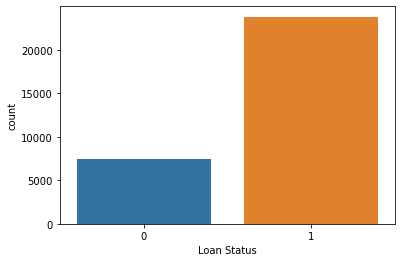

In [55]:
sns.countplot(x='Loan Status',data=df_train)# To be treated as imbalance data set
#1=fully paid 0= Charged Off

In [56]:
# Resample minority class to equal majority class
from sklearn.utils import resample
minority = df_train[df_train['Loan Status'] == 0]
majority = df_train[df_train['Loan Status'] == 1]

# Upsample the minority class to match the number of majority class samples
minority_upsampled = resample(minority, replace=True, n_samples=len(majority), random_state=42)

# Concatenate the majority class and upsampled minority class
df_train_2 = pd.concat([majority, minority_upsampled], axis=0)

<AxesSubplot:xlabel='Loan Status', ylabel='count'>

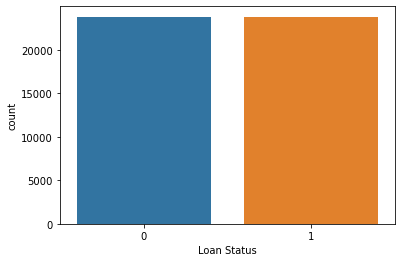

In [57]:
sns.countplot(x='Loan Status',data=df_train_2)

In [58]:
df_train_2.head()

,Loan Status,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
2,1,99999999.0,1,741.0,2231892.0,8.0,2,3,29200.53,14.9,29.0,18.0,1.0,297996.0,750090.0,0.0,0.0
6,1,217646.0,1,730.0,1184194.0,1.0,1,3,10855.08,19.6,10.0,13.0,1.0,122170.0,272052.0,1.0,0.0
8,1,548746.0,1,678.0,2559110.0,2.0,3,3,18660.28,22.6,33.0,4.0,0.0,437171.0,555038.0,0.0,0.0
10,1,99999999.0,1,728.0,714628.0,3.0,3,3,11851.06,16.0,76.0,16.0,0.0,203965.0,289784.0,0.0,0.0
12,1,99999999.0,1,740.0,776188.0,1.0,2,3,11578.22,8.5,25.0,6.0,0.0,134083.0,220220.0,0.0,0.0


In [59]:
df_test.head()

,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
2,153494.0,1,709.0,871112.0,2.0,3,3,8391.73,12.5,10.0,10.0,0.0,38532.0,388036.0,0.0,0.0
3,176242.0,1,727.0,780083.0,10.0,3,3,16771.87,16.5,27.0,16.0,1.0,156940.0,531322.0,1.0,0.0
4,321992.0,1,744.0,1761148.0,10.0,1,3,39478.77,26.0,44.0,14.0,0.0,359765.0,468072.0,0.0,0.0
9,266288.0,0,683.0,2031518.0,2.0,3,3,12443.10,24.4,56.0,8.0,2.0,31445.0,251130.0,2.0,0.0
11,258104.0,1,723.0,1284514.0,7.0,3,3,6368.99,14.6,64.0,12.0,0.0,128402.0,266904.0,0.0,0.0


### Data Normalization

In [60]:
from sklearn.preprocessing import MinMaxScaler
X=df_train_2.drop(['Loan Status'],axis=1)
X_transform= MinMaxScaler().fit_transform(X)
y = df_train_2['Loan Status']
X_2=df_test

In [61]:
df_train_2.columns

Index(['Loan Status', 'Current Loan Amount', 'Term', 'Credit Score',
       'Annual Income', 'Years in current job', 'Home Ownership', 'Purpose',
       'Monthly Debt', 'Years of Credit History',
       'Months since last delinquent', 'Number of Open Accounts',
       'Number of Credit Problems', 'Current Credit Balance',
       'Maximum Open Credit', 'Bankruptcies', 'Tax Liens'],
      dtype='object')

In [62]:
df_test.columns

Index(['Current Loan Amount', 'Term', 'Credit Score', 'Annual Income',
       'Years in current job', 'Home Ownership', 'Purpose', 'Monthly Debt',
       'Years of Credit History', 'Months since last delinquent',
       'Number of Open Accounts', 'Number of Credit Problems',
       'Current Credit Balance', 'Maximum Open Credit', 'Bankruptcies',
       'Tax Liens'],
      dtype='object')

In [63]:
#X_train=X
#X_test=X_2
#y_train=y
#y_test=

## Training Machine Learning  Classifiers :Random Forest and XGBoost

### Random Forest

In [64]:
# Split the data into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_transform, y, test_size=0.2, random_state=42)

In [65]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

In [66]:
# Create a Random Forest Classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the classifier on the training data
rf_classifier.fit(X_train, y_train)

# Make predictions on the test data
y_pred = rf_classifier.predict(X_test)

# Evaluate the performance
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Additional evaluation metrics
print("Classification Report:\n", classification_report(y_test, y_pred))

# Display confusion matrix
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))

Accuracy: 0.95
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.95      0.95      4788
           1       0.95      0.95      0.95      4734

    accuracy                           0.95      9522
   macro avg       0.95      0.95      0.95      9522
weighted avg       0.95      0.95      0.95      9522

Confusion Matrix:
 [[4548  240]
 [ 245 4489]]


In [67]:
X_test2 = df_test  # Assuming df_test is your test dataset
y_test_pred = rf_classifier.predict(X_test2)

C:\Users\LENOVO\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


In [68]:
y_test_pred

array([0, 0, 0, ..., 0, 0, 0])

### XGBoost

In [69]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

In [70]:
# Create an XGBoost classifier
model = xgb.XGBClassifier(objective="multi:softmax", num_class=len(set(y)))

In [71]:
# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Display classification report
print("Classification Report:")
print(classification_report(y_test, y_pred))

# Obtain the confusion matrix
conf_matrix1 = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix1)

Accuracy: 0.81
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.82      0.81      4788
           1       0.81      0.80      0.81      4734

    accuracy                           0.81      9522
   macro avg       0.81      0.81      0.81      9522
weighted avg       0.81      0.81      0.81      9522

Confusion Matrix:
[[3918  870]
 [ 954 3780]]


## The idea behind hyperoptimisation is to improved the model's classification ability

### Hyperparameter Optimisation of XGBoost Classifier

In [72]:
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import warnings

# To ignore all warnings
warnings.filterwarnings("ignore")


# Define the hyperparameters and their possible values
param_dist = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create the randomized search with cross-validation
random_search1 = RandomizedSearchCV(
    estimator=model,
    param_distributions=param_dist,
    n_iter=10,  # Number of parameter settings that are sampled
    cv=3,       # Number of folds in cross-validation
    scoring='accuracy',
    random_state=42
)

# Fit the randomized search to the data
random_search1.fit(X_train, y_train)

# Get the best hyperparameters
best_params = random_search1.best_params_
print("Best Hyperparameters:", best_params)

# Use the best model to make predictions
best_model1 = random_search1.best_estimator_
y_pred = best_model1.predict(X_test)

# Evaluate the performance
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")
# Obtain the confusion matrix

conf_matrix2 = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix2)

[13:07:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "min_samples_leaf", "min_samples_split" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[13:08:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "min_samples_leaf", "min_samples_split" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[13:08:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parame

[13:11:20] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "min_samples_leaf", "min_samples_split" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[13:11:29] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parameters: { "min_samples_leaf", "min_samples_split" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[13:11:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/learner.cc:627: 
Parame

### Hyperparameter of RandomForest Classifier

In [73]:
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
import warnings

# To ignore all warnings
warnings.filterwarnings("ignore")


# Define the hyperparameters and their possible values
param_dist = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create the randomized search with cross-validation
random_search2 = RandomizedSearchCV(
    estimator=rf_classifier,
    param_distributions=param_dist,
    n_iter=10,  # Number of parameter settings that are sampled
    cv=3,       # Number of folds in cross-validation
    scoring='accuracy',
    random_state=42
)

# Fit the randomized search to the data
random_search2.fit(X_train, y_train)

# Get the best hyperparameters
best_params = random_search2.best_params_
print("Best Hyperparameters:", best_params)

# Use the best model to make predictions
best_model2 = random_search2.best_estimator_
y_pred = best_model2.predict(X_test)

# Evaluate the performance
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")
# Obtain the confusion matrix

conf_matrix3 = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix3)

Best Hyperparameters: {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': None}
Accuracy: 0.95
Confusion Matrix:
[[4550  238]
 [ 228 4506]]


## Pikling all models

In [74]:
# Save the trained model to a PKL file
import pickle
with open('rf_classifier.pkl', 'wb') as file:
    pickle.dump(rf_classifier, file)

In [75]:
# Save the trained model to a PKL file
import pickle
with open('model.pkl', 'wb') as file:
    pickle.dump(model, file)

In [76]:
# Save the trained model to a PKL file
import pickle
with open('best_model1.pkl', 'wb') as file:
    pickle.dump(best_model1, file)

In [77]:
# Save the trained model to a PKL file
import pickle
with open('best_model2.pkl', 'wb') as file:
    pickle.dump(best_model2, file)